In [1]:
import torch
import numpy as np
import os
import pickle
from utils import *
import pandas as pd
import matplotlib.pyplot as plt

from utils import *

# Mirror 1: Sensor 5, 6, 7 and 8

In [3]:
data_sensor_5 = torch.Tensor(np.log(datasensor(sensor="sensor_5",
                                                path="examplefilter/UT1"
                                                ).dropna().values)).float()
data_sensor_6 = torch.Tensor(np.log(datasensor(sensor="sensor_6",
                                                path="examplefilter/UT1").dropna().values)).float()
data_sensor_7 = torch.Tensor(np.log(datasensor(sensor="sensor_7",
                                                path="examplefilter/UT1").dropna().values)).float()
data_sensor_8 = torch.Tensor(np.log(datasensor(sensor="sensor_8",
                                                path="examplefilter/UT1").dropna().values)).float()

time = datasensor("sensor_8").dropna().index.values

freq = datasensor("sensor_8").columns.astype(float)



In [ ]:

path_models = "./models"

# load the models
model_sensor_5 = torch.load(path_models+"/sensor_5")
model_sensor_6 = torch.load(path_models+"/sensor_6")
model_sensor_7 = torch.load(path_models+"/sensor_7")
model_sensor_8 = torch.load(path_models+"/sensor_8")


In [5]:
# extracction of the difference between the input and the output of the autoencoder
model_sensor_5.eval()
model_sensor_6.eval()
model_sensor_7.eval()
model_sensor_8.eval()

with torch.no_grad():
    datos_reconstruidos_5 = model_sensor_5(data_sensor_5)
    datos_reconstruidos_6 = model_sensor_6(data_sensor_6)
    datos_reconstruidos_7 = model_sensor_7(data_sensor_7)
    datos_reconstruidos_8 = model_sensor_8(data_sensor_8)


# Calcular la pérdida de reconstruccón (error)
error_5 = torch.mean((data_sensor_5 - datos_reconstruidos_5)**2, axis=1).numpy()
error_6 = torch.mean((data_sensor_6 - datos_reconstruidos_6)**2, axis=1).numpy()
error_7 = torch.mean((data_sensor_7 - datos_reconstruidos_7)**2, axis=1).numpy()
error_8 = torch.mean((data_sensor_8 - datos_reconstruidos_8)**2, axis=1).numpy()




difference= pd.DataFrame({"time": time, "error_5": error_5, 
                                                "error_6": error_6,
                                                "error_7": error_7,
                                                "error_8": error_8})

difference['max'] = difference[['error_5', 'error_6', 'error_7', 'error_8']].max(axis=1)
difference['desviacion'] = difference[['error_5', 'error_6', 'error_7', 'error_8']].std(axis=1)
difference['promedio'] = difference[['error_5', 'error_6', 'error_7', 'error_8']].mean(axis=1)
difference['anomalias'] = difference['promedio'] > 1.1


In [6]:
difference

,time,error_5,error_6,error_7,error_8,max,desviacion,promedio,anomalias
0,2021-01-30 00:11:00,0.394433,0.335529,0.213128,0.279699,0.394433,0.077479,0.305697,False
1,2021-01-30 00:13:00,0.318834,0.251980,0.216872,0.247107,0.318834,0.042993,0.258698,False
2,2021-01-30 00:14:00,0.383435,0.344495,0.233302,0.249215,0.383435,0.072897,0.302612,False
3,2021-01-30 00:15:00,0.313248,0.279176,0.254279,0.254587,0.313248,0.027845,0.275323,False
4,2021-01-30 00:16:00,0.346144,0.311750,0.270043,0.293330,0.346144,0.032125,0.305317,False
...,...,...,...,...,...,...,...,...,...
37912,2022-05-23 10:28:00,0.198496,0.287282,0.244616,0.198955,0.287282,0.042542,0.232337,False
37913,2022-05-23 10:29:00,0.214830,0.278106,0.250950,0.232896,0.278106,0.026991,0.244195,False
37914,2022-05-23 10:30:00,0.367825,0.351874,0.257512,0.209380,0.367825,0.075859,0.296648,False
37915,2022-05-23 10:31:00,0.233539,0.272207,0.241311,0.241640,0.272207,0.017103,0.247174,False


In [7]:
import plotly.express as px

# making the interactive figure
fig = px.scatter(difference, x='time', y='max')

# Personalizar la figura
fig.update_layout(
    title="Errors over the time of the mirror 1",
    xaxis_title="Time",
    yaxis_title="MAx Error"
)

# Mostrar la figura interactiva
fig.show()

In [8]:
# Crear la figura interactiva
fig = px.scatter(difference, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibrations over the time of the mirror 1",
    xaxis_title="Time",
    yaxis_title="Mean Error"
)



# Mostrar la figura interactiva
fig.show()

### Example of anomaly

In [9]:

# Convertir los datos a un objeto DataFrame de Pandas
df = pd.DataFrame(time, columns=['fecha'])

# Convertir la columna 'fecha' al tipo datetime
df['fecha'] = pd.to_datetime(df['fecha'])

# Filtrar los datos entre enero y febrero
filtro_anomalia = (df['fecha'].dt.year == 2021) & (df['fecha'].dt.month == 4) & (df['fecha'].dt.day >= 1) & (df['fecha'].dt.day <= 5)

# Filtro de datos normales: menor a febrero 14 de 2021
filtro_normal = (df['fecha'] < pd.to_datetime('2021-02-14'))



In [10]:
import seaborn as sns
parameters = {'axes.labelsize': 16,
                'axes.titlesize': 25,
                "xtick.labelsize": 12,
                "ytick.labelsize": 12}

plt.rcParams.update(parameters)

sns.set_style("darkgrid")
freq = freq.astype(float)

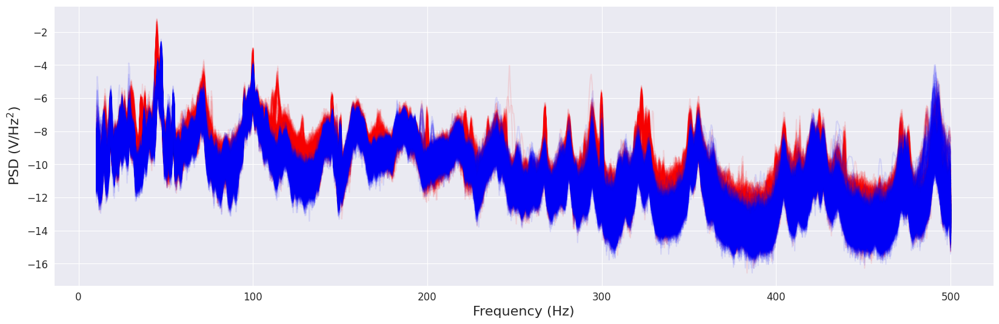

In [11]:

plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_5.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_5.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")

plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

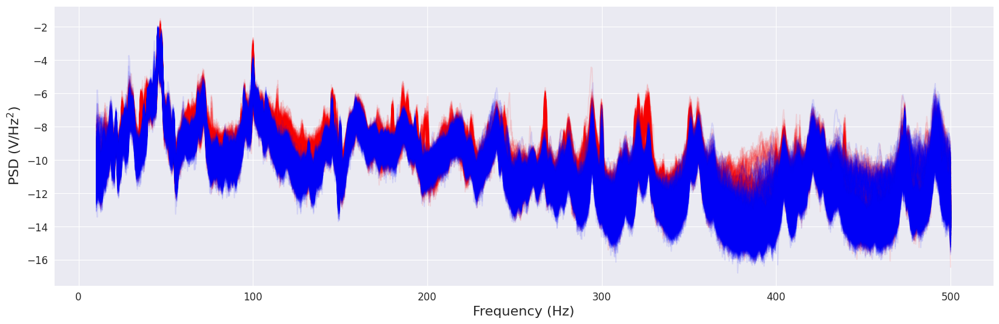

In [12]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_6.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_6.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")




    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

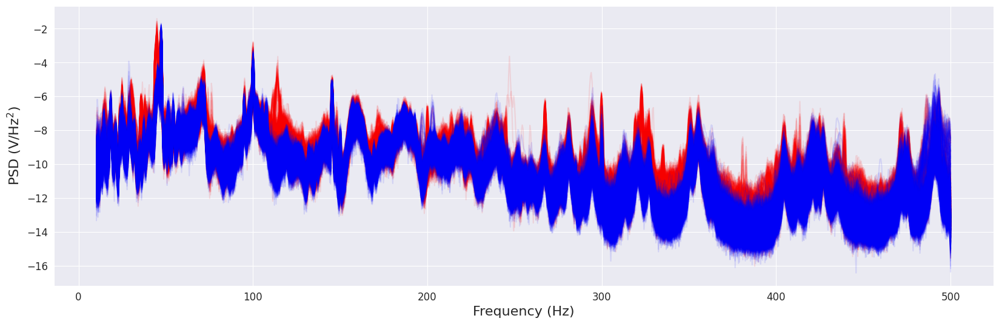

In [13]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_7.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_7.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")


    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

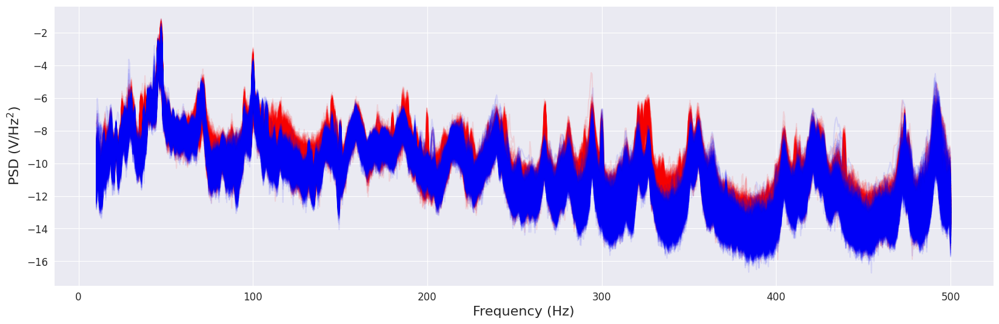

In [14]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_8.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")
    
data_sensor_5_normal = data_sensor_8.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")


    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

## Mirror 2: Sensor 1 and 2

In [15]:
data_sensor_1 = torch.Tensor(np.log(datasensor("sensor_1").dropna().values)).float()
data_sensor_2 = torch.Tensor(np.log(datasensor("sensor_2").dropna().values)).float()

time = datasensor("sensor_1").dropna().index.values

freq = datasensor("sensor_1").columns.astype(float)

In [16]:
# Ruta del archivo donde se guardó el model
ruta_actual = "./models"

# Cargar el modelo
model_sensor_1 = torch.load(ruta_actual+"/sensor_1")
model_sensor_2 = torch.load(ruta_actual+"/sensor_2")

In [17]:
model_sensor_1.eval()
model_sensor_2.eval()


with torch.no_grad():
    datos_reconstruidos_1 = model_sensor_1(data_sensor_1)
    datos_reconstruidos_2 = model_sensor_2(data_sensor_2)


# Calcular la pérdida de reconstruccón (error)
error_1 = torch.mean((data_sensor_1 - datos_reconstruidos_1)**2, axis=1).numpy()
error_2 = torch.mean((data_sensor_2 - datos_reconstruidos_2)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_1": error_1, 
                                                "error_2": error_2,
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_1', 'error_2']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_1', 'error_2']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_1', 'error_2']].mean(axis=1)


In [18]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del Espejo 2",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

In [19]:
import pandas as pd

# Convertir los datos a un objeto DataFrame de Pandas
df = pd.DataFrame(time, columns=['fecha'])

# Convertir la columna 'fecha' al tipo datetime
df['fecha'] = pd.to_datetime(df['fecha'])

# Filtrar las anomalías (mayo de 2022 con valores mayores a 1)
filtro_anomalia = (df['fecha'].dt.year >= 2022) & (df['fecha'].dt.month == 5) & (df['fecha'].dt.day > 1) 

# Filtrar los datos normales (febrero 20 del 2021 a marzo 5 del 2021)
filtro_normal = (df['fecha'].dt.year == 2021) & (df['fecha'].dt.month == 2) & (df['fecha'].dt.day >= 20) | (df['fecha'].dt.year == 2021) & (df['fecha'].dt.month == 3) & (df['fecha'].dt.day <= 5)



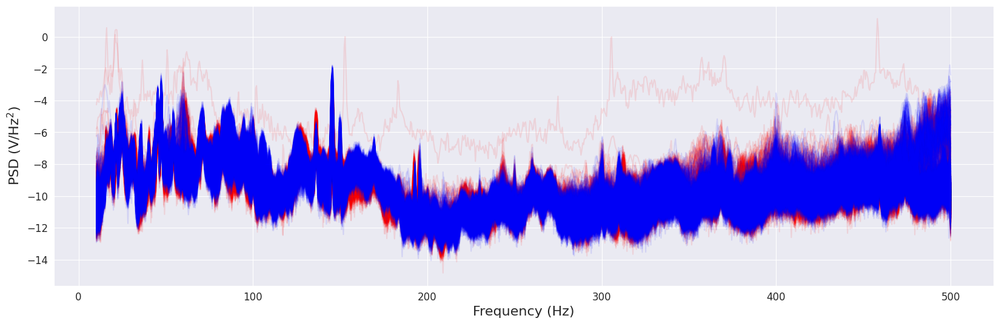

In [20]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_1.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_1.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")




    
plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

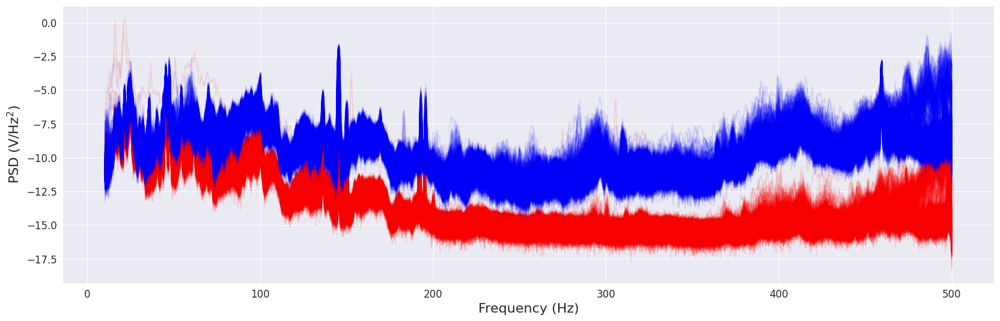

In [21]:
plt.figure(figsize=(20,6)) 

data_sensor_5_normal = data_sensor_2.numpy()[filtro_anomalia]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="red")

data_sensor_5_normal = data_sensor_2.numpy()[filtro_normal]
for i in range(len(data_sensor_5_normal)):
    plt.plot(freq, data_sensor_5_normal[i], alpha=0.1, color="blue")

plt.ylabel(r"$\mathrm{PSD\ (V/Hz^2)}$") 
plt.xlabel("Frequency (Hz)")
plt.show()

# Sensor 3

In [22]:
data_sensor_3 = torch.Tensor(np.log(datasensor("sensor_3").dropna().values)).float()

time = datasensor("sensor_3").dropna().index.values

freq = datasensor("sensor_3").columns.astype(float)

In [23]:
# Ruta del archivo donde se guardó el model
ruta_actual = "./models"

# Cargar el modelo
model_sensor_3 = torch.load(ruta_actual+"/sensor_3")

In [24]:
model_sensor_3.eval()


with torch.no_grad():
    datos_reconstruidos_3 = model_sensor_3(data_sensor_3)


# Calcular la pérdida de reconstruccón (error)
error_3 = torch.mean((data_sensor_3 - datos_reconstruidos_3)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_3": error_3, 
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_3']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_3']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_3']].mean(axis=1)

In [25]:
datos_con_tiempos

,time,error_3,max,desviacion,promedio
0,2021-01-30 00:11:00,0.359648,0.359648,NaN,0.359648
1,2021-01-30 00:13:00,0.392923,0.392923,NaN,0.392923
2,2021-01-30 00:14:00,0.443227,0.443227,NaN,0.443227
3,2021-01-30 00:15:00,0.387627,0.387627,NaN,0.387627
4,2021-01-30 00:16:00,0.328663,0.328663,NaN,0.328663
...,...,...,...,...,...
37912,2022-05-23 10:28:00,0.449408,0.449408,NaN,0.449408
37913,2022-05-23 10:29:00,0.416362,0.416362,NaN,0.416362
37914,2022-05-23 10:30:00,0.413311,0.413311,NaN,0.413311
37915,2022-05-23 10:31:00,0.388246,0.388246,NaN,0.388246


In [26]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del sensor 3",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

# Sensor 4

In [27]:
data_sensor_4 = torch.Tensor(np.log(datasensor("sensor_4").dropna().values)).float()

time = datasensor("sensor_4").dropna().index.values

freq = datasensor("sensor_4").columns.astype(float)

In [28]:
# Ruta del archivo donde se guardó el model
ruta_actual = "./models"

# Cargar el modelo
model_sensor_4 = torch.load(ruta_actual+"/sensor_4")

In [29]:
model_sensor_4.eval()


with torch.no_grad():
    datos_reconstruidos_4 = model_sensor_4(data_sensor_4)


# Calcular la pérdida de reconstruccón (error)
error_4 = torch.mean((data_sensor_4 - datos_reconstruidos_4)**2, axis=1).numpy()




datos_con_tiempos= pd.DataFrame({"time": time, "error_4": error_4, 
                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_4']].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_4']].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_4']].mean(axis=1)

In [30]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones del sensor 4",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()

# Sensores M

In [31]:
data_m1 = torch.Tensor(np.log(datasensor("m1").dropna().values)).float()
data_m1_3 = torch.Tensor(np.log(datasensor("m1-3").dropna().values)).float()
data_m2 = torch.Tensor(np.log(datasensor("m2").dropna().values)).float()
data_m3 = torch.Tensor(np.log(datasensor("m3").dropna().values)).float()

time = datasensor("m3").dropna().index.values

freq = datasensor("m3").columns.astype(float)

In [32]:
# Ruta del archivo donde se guardó el model
ruta_actual = "./models"

# Cargar el modelo
model_m1 = torch.load(ruta_actual+"/m1")
model_m1_3 = torch.load(ruta_actual+"/m1-3")
model_m2 = torch.load(ruta_actual+"/m2")
model_m3 = torch.load(ruta_actual+"/m3")


In [33]:
model_m1.eval()
model_m1_3.eval()
model_m2.eval()
model_m3.eval()



with torch.no_grad():
    datos_reconstruidos_m1 = model_m1(data_m1)
    datos_reconstruidos_m1_3 = model_m1_3(data_m1_3)
    datos_reconstruidos_m2 = model_m2(data_m2)
    datos_reconstruidos_m3 = model_m3(data_m3)



# Calcular la pérdida de reconstruccón (error)
error_m1 = torch.mean((data_m1 - datos_reconstruidos_m1)**2, axis=1).numpy()
error_m1_3 = torch.mean((data_m1_3 - datos_reconstruidos_m1_3)**2, axis=1).numpy()
error_m2 = torch.mean((data_m2 - datos_reconstruidos_m2)**2, axis=1).numpy()
error_m3 = torch.mean((data_m3 - datos_reconstruidos_m3)**2, axis=1).numpy()





datos_con_tiempos= pd.DataFrame({"time": time, "error_m1": error_m1, 
                                                "error_m1_3": error_m1_3, 
                                                "error_m2": error_m2, 
                                                "error_m3": error_m3, 

                                                })

datos_con_tiempos['max'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].max(axis=1)
datos_con_tiempos['desviacion'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].std(axis=1)
datos_con_tiempos['promedio'] = datos_con_tiempos[['error_m1', "error_m1_3", "error_m2","error_m3" ]].mean(axis=1)

In [34]:
# Crear la figura interactiva
fig = px.scatter(datos_con_tiempos, x='time', y='promedio')

# fig.add_hline(y=1.2)

# Personalizar la figura
fig.update_layout(
    title="Vibraciones de los sensores m",
    xaxis_title="Tiempo",
    yaxis_title="Error promedio"
)



# Mostrar la figura interactiva
fig.show()